In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display, HTML
from tensorflow.keras.layers import Input, LSTM, Dense, Dropout, Embedding, Concatenate, Flatten, Reshape
from tensorflow.keras.models import Model
from random import shuffle
import datetime
import math

In [55]:
pd.set_option('display.max_rows', 100)
#Just to have each print in the same row
CSS = """
.output {
    flex-direction: column;
}
"""

HTML('<style>{}</style>'.format(CSS))

In [56]:
r'''   
data_w_operacion: (DataFrame) data with their corresponding operacion (Entrada/Salida).
    path: C:\Users\ing_l\Tesis grado\Data\SUMO_data_w_operacion.csv

'''

data_path = r'C:\Users\ing_l\Tesis grado\Data\SUMO_data_w_operacion.csv'

In [106]:
data = pd.read_csv(data_path, parse_dates=['fecha_tiempo'])

# MODIFICAR EL TIEMPO DE DATA PARA QUE VAYA CADA UN TIEMPO ESTABLECIDO (cada 5 minutos por ejemplo).

# TAMBIEN TENGO QUE TENER CUIDADO CUANDO SE CAMBIA EL DIA, TENDRIA QUE TENER ESO EN CUENTA TAMBIEN CUANDO TOMO LOS DATOS

In [107]:
data['dia de semana'] = data['fecha_tiempo'].apply(lambda x: pd.Timestamp(x).weekday())
data['tiempo'] = data['tiempo'].apply(lambda x: pd.Timestamp(x).time())
data

,id_cuadra,direccion,fecha,tiempo,ocupacion,lugares_cuadra,ocupacion_max,dispon_parq,altas_bajas(dia),fecha_tiempo,operacion,dia de semana
0,2,General Pinto 545,11-09-19,17:15:31,6,27.0,17,green,184,2019-09-11 17:15:31,NaN,2
1,2,General Pinto 545,11-09-19,17:20:25,7,27.0,17,green,184,2019-09-11 17:20:25,Entrada,2
2,2,General Pinto 545,11-09-19,17:34:54,6,27.0,17,green,190,2019-09-11 17:34:54,Salida,2
3,2,General Pinto 545,11-09-19,17:40:09,5,27.0,17,green,191,2019-09-11 17:40:09,Salida,2
4,2,General Pinto 545,11-09-19,17:45:05,6,27.0,17,green,192,2019-09-11 17:45:05,Entrada,2
...,...,...,...,...,...,...,...,...,...,...,...,...
264063,99,Av. España 970,09-12-19,08:55:58,1,NaN,1,green,1,2019-12-09 08:55:58,Entrada,0
264064,99,Av. España 970,09-12-19,09:24:34,2,NaN,2,green,2,2019-12-09 09:24:34,Entrada,0
264065,99,Av. España 970,09-12-19,09:43:53,3,NaN,3,green,3,2019-12-09 09:43:53,Entrada,0
264066,99,Av. España 970,09-12-19,09:49:53,4,NaN,4,green,4,2019-12-09 09:49:53,Entrada,0


In [119]:
#Me quedo con los que estan entre las 8 y las 21hs
data = data.loc[(data.tiempo > datetime.time(8)) & (data.tiempo < datetime.time(21))].reset_index(drop=True)

In [120]:
data[0:50]

,id_cuadra,direccion,fecha,tiempo,ocupacion,lugares_cuadra,ocupacion_max,dispon_parq,altas_bajas(dia),fecha_tiempo,operacion,dia de semana
0,2,General Pinto 545,11-09-19,17:15:31,6,27.0,17,green,184,2019-09-11 17:15:31,NaN,2
1,2,General Pinto 545,11-09-19,17:20:25,7,27.0,17,green,184,2019-09-11 17:20:25,Entrada,2
2,2,General Pinto 545,11-09-19,17:34:54,6,27.0,17,green,190,2019-09-11 17:34:54,Salida,2
3,2,General Pinto 545,11-09-19,17:40:09,5,27.0,17,green,191,2019-09-11 17:40:09,Salida,2
4,2,General Pinto 545,11-09-19,17:45:05,6,27.0,17,green,192,2019-09-11 17:45:05,Entrada,2
5,2,General Pinto 545,11-09-19,17:54:43,7,27.0,17,green,197,2019-09-11 17:54:43,Entrada,2
6,2,General Pinto 545,11-09-19,18:00:29,8,27.0,17,green,200,2019-09-11 18:00:29,Entrada,2
7,2,General Pinto 545,11-09-19,18:00:29,9,27.0,17,green,200,2019-09-11 18:02:18,Entrada,2
8,2,General Pinto 545,11-09-19,18:04:18,10,27.0,17,green,203,2019-09-11 18:04:18,Entrada,2
9,2,General Pinto 545,11-09-19,18:04:18,11,27.0,17,green,203,2019-09-11 18:06:27,Entrada,2


In [121]:
max_street_num = data.loc[:,'id_cuadra'].max()
print('Max street id: ', max_street_num)

Max street id:  99


In [29]:
'''
Solo si quiero eliminar los que tienen None, aunque como no los usare no tiene sentido eliminarlos
'''
'''
def delete_nans(row):
    if isinstance(row, float):
        return 'vacio'
    return row

data.operacion = data['operacion'].apply(delete_nans)

data = data.loc[data.operacion != 'vacio'].reset_index(drop=True)'''

"\ndef delete_nans(row):\n    if isinstance(row, float):\n        return 'vacio'\n    return row\n\ndata.operacion = data['operacion'].apply(delete_nans)\n\ndata = data.loc[data.operacion != 'vacio'].reset_index(drop=True)"

In [30]:
'''data[['id_cuadra','fecha_tiempo', 'dia de semana', 'ocupacion','operacion']]'''

"data[['id_cuadra','fecha_tiempo', 'dia de semana', 'ocupacion','operacion']]"

### En este intento voy a utilizar como dato de tiempo el dia de la semana y la hora

In [122]:
'''
La idea de la red seria que de input tenga fecha_tiempo (o por ahi mejor, solo dia de la semana), 
la ocupacion de esa fecha_tiempo, el clima.
Como output deberia tener la ocupacion de ese momento.

Aparte a todo eso se deberia ver la ocupacion actual y la ocupacion maxima para saber si hay lugar libre.
'''

def to_seconds(time):
    '''transform datetime.time to seconds'''
    return time.hour * 60 * 60 + time.minute * 60 + time.second

def normalize_time(time):
    '''normalize time (in seconds) to values bertween 0 and 1'''
    max_time = 23 * 60 * 60 + 59 * 60 + 59
    return time / max_time

def modify_operation(operation):
    '''if operacion == Entrada put 1, == NaN put 0 and == Salida put -1'''
    if operation == 'Entrada':
        return 1
    if operation == 'Salida':
        return -1
    return 0

data_week = data.loc[:, ['id_cuadra','dia de semana', 'tiempo', 'ocupacion','operacion']]
data_week['tiempo'] = data_week['tiempo'].apply(to_seconds)
data_week['operacion'] = data_week['operacion'].apply(modify_operation)

In [170]:
'''data_week[0:32]'''

,id_cuadra,dia de semana,tiempo,ocupacion,operacion
0,2,2,62131,6,0
1,2,2,62425,7,1
2,2,2,63294,6,-1
3,2,2,63609,5,-1
4,2,2,63905,6,1
5,2,2,64483,7,1
6,2,2,64829,8,1
7,2,2,64829,9,1
8,2,2,65058,10,1
9,2,2,65058,11,1


In [232]:
'''data_week[0:50]'''

,id_cuadra,dia de semana,tiempo,ocupacion,operacion
0,2,2,62131,6,0
1,2,2,62425,7,1
2,2,2,63294,6,-1
3,2,2,63609,5,-1
4,2,2,63905,6,1
5,2,2,64483,7,1
6,2,2,64829,8,1
7,2,2,64829,9,1
8,2,2,65058,10,1
9,2,2,65058,11,1


In [220]:
#To obtain the start and finish of each day, usefull to normalize data times

indexes = [0]

total_len = 1

x = data_week.reset_index()
exit = False
while (total_len > 0) and not exit:
    print(indexes)
    total_len = len(x.loc[x.loc[indexes[-1]:, 'dia de semana'].drop_duplicates().index, 'index'])
    try:
        indexes.append(x.loc[x.loc[indexes[-1]:, 'dia de semana'].drop_duplicates().index, 'index'].iloc[1])
    except:
        exit = True
        print('Work complete.')

[0]
[0, 33]
[0, 33, 113]
[0, 33, 113, 222]
[0, 33, 113, 222, 258]
[0, 33, 113, 222, 258, 332]
[0, 33, 113, 222, 258, 332, 357]
[0, 33, 113, 222, 258, 332, 357, 417]
[0, 33, 113, 222, 258, 332, 357, 417, 491]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845]
[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629]

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

[0, 33, 113, 222, 258, 332, 357, 417, 491, 510, 561, 610, 694, 807, 854, 928, 966, 1040, 1167, 1211, 1296, 1331, 1428, 1578, 1631, 1720, 1753, 1823, 1923, 1960, 2013, 2046, 2112, 2198, 2231, 2281, 2292, 2311, 2359, 2374, 2404, 2435, 2519, 2630, 2664, 2734, 2779, 2877, 3024, 3078, 3126, 3140, 3173, 3278, 3288, 3335, 3347, 3391, 3489, 3518, 3581, 3611, 3671, 3783, 3815, 3880, 3909, 3973, 4065, 4089, 4159, 4180, 4247, 4347, 4380, 4437, 4475, 4543, 4650, 4657, 4709, 4743, 4813, 4968, 4999, 5068, 5086, 5142, 5218, 5244, 5296, 5316, 5387, 5492, 5519, 5586, 5611, 5681, 5810, 5835, 5911, 5922, 5953, 6006, 6022, 6055, 6072, 6074, 6081, 6096, 6126, 6131, 6158, 6184, 6222, 6296, 6318, 6348, 6380, 6448, 6576, 6609, 6685, 6686, 6695, 6724, 6732, 6761, 6774, 6800, 6854, 6895, 6925, 6937, 6940, 6943, 6987, 7012, 7074, 7164, 7171, 7223, 7271, 7358, 7463, 7492, 7511, 7551, 7623, 7635, 7731, 7769, 7845, 7960, 7993, 8056, 8081, 8155, 8250, 8274, 8331, 8355, 8391, 8454, 8468, 8502, 8510, 8562, 8620, 8629,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [207]:
'''indexes'''

[0, 33]

In [188]:
'''x[19530:19550]'''

,index,id_cuadra,dia de semana,tiempo,ocupacion,operacion
19530,19530,2,0,72300,9,-1
19531,19531,2,0,73428,8,-1
19532,19532,2,0,74135,7,-1
19533,19533,2,1,28946,1,1
19534,19534,2,1,31794,2,1
19535,19535,2,1,33838,3,1
19536,19536,2,1,34085,2,-1
19537,19537,2,1,34085,3,1
19538,19538,2,1,34085,4,1
19539,19539,2,1,35037,5,1


In [178]:
#ACA DEBERIA ESTAR LO DE ARMAR LOS 5 MINUTOS
#ESTE FUNCIONA PERO SOLO PARA UN DIA
#Suponiendo que me llega solo un df conteniendo un solo dia (y esto lo hago para todos los dias y para cada calle)
def normalize_data_period(data, period=5):
    '''
        normalize data in periods for a day
    '''
    seconds = period * 60
    out = pd.DataFrame(columns=['id_cuadra','dia de semana','tiempo','ocupacion','operacion'])
    out = out.append(data.iloc[0])
    dist_to_period = out.iloc[-1].tiempo % seconds
    if (dist_to_period) != 0:
        out.iloc[-1].tiempo = out.iloc[-1].tiempo - dist_to_period
        
    for i in range(math.ceil((data.iloc[-1].tiempo - data.iloc[0].tiempo) / seconds)):
        next_period = data.loc[data.tiempo < (out.iloc[-1].tiempo+seconds)]
        if (len(next_period) == 0):
            out = out.append(out.iloc[-1])
            out.iloc[-1].tiempo = out.iloc[-1] + seconds
        else:
            out = out.append(next_period.iloc[-1])
            out.iloc[-1].tiempo = out.iloc[-2].tiempo + seconds
        if ( out.iloc[-2].ocupacion == out.iloc[-1].ocupacion):
            out.iloc[-2].operacion = 0
    return out.reset_index(drop=True)


,id_cuadra,dia de semana,tiempo,ocupacion,operacion
0,2,2,62100,6,0
1,2,2,62400,6,0
2,2,2,62700,7,0
3,2,2,63000,7,1
4,2,2,63300,6,0
5,2,2,63600,6,-1
6,2,2,63900,5,-1
7,2,2,64200,6,1
8,2,2,64500,7,0
9,2,2,64800,7,1


In [239]:
#Normalizes all the data times. Put intervals of x minutes
normalized_data = pd.DataFrame(columns=['id_cuadra','dia de semana','tiempo','ocupacion','operacion'])
for i in range(len(indexes)-1):
    normalized_data = normalized_data.append(normalize_data_period(data_week[indexes[i]:indexes[i+1]]))
normalized_data = normalized_data.append(normalize_data_period(data_week[indexes[-1]:len(data_week)]))

In [235]:
'''normalized_data[0:55]'''

,id_cuadra,dia de semana,tiempo,ocupacion,operacion
0,2,2,62100,6,0
1,2,2,62400,6,0
2,2,2,62700,7,0
3,2,2,63000,7,1
4,2,2,63300,6,0
5,2,2,63600,6,-1
6,2,2,63900,5,-1
7,2,2,64200,6,1
8,2,2,64500,7,0
9,2,2,64800,7,1


In [236]:
'''data_week[32:50]'''

,id_cuadra,dia de semana,tiempo,ocupacion,operacion
32,2,2,74927,2,-1
33,2,3,47911,8,1
34,2,3,48255,9,1
35,2,3,48255,8,-1
36,2,3,48866,7,-1
37,2,3,48866,8,1
38,2,3,49238,9,1
39,2,3,49238,10,1
40,2,3,49238,11,1
41,2,3,49238,12,1


In [248]:
'''normalized_data[-20:-1]'''

,id_cuadra,dia de semana,tiempo,ocupacion,operacion
80,99,3,55500,0,0
81,99,3,55800,0,0
82,99,3,56100,0,0
83,99,3,56400,0,-1
84,99,3,56700,1,0
85,99,3,57000,1,1
0,99,0,32100,1,0
1,99,0,32400,1,0
2,99,0,32700,1,0
3,99,0,33000,1,0


In [244]:
'''data_week[-10:-1]'''

,id_cuadra,dia de semana,tiempo,ocupacion,operacion
257747,99,3,51244,2,-1
257748,99,3,51566,1,-1
257749,99,3,55353,0,-1
257750,99,3,56536,1,1
257751,99,3,57113,0,-1
257752,99,0,32158,1,1
257753,99,0,33874,2,1
257754,99,0,35033,3,1
257755,99,0,35393,4,1


In [250]:
normalized_data['tiempo'] = normalized_data['tiempo'].apply(normalize_time)

In [112]:
'''data_week'''

,id_cuadra,dia de semana,tiempo,ocupacion,operacion
0,2,2,62131,6,NaN
1,2,2,62425,7,Entrada
2,2,2,63294,6,Salida
3,2,2,63609,5,Salida
4,2,2,63905,6,Entrada
...,...,...,...,...,...
264063,99,0,32158,1,Entrada
264064,99,0,33874,2,Entrada
264065,99,0,35033,3,Entrada
264066,99,0,35393,4,Entrada


In [60]:
'''print(data_week[0:50].iloc[0].tiempo)
print(data[0:50].iloc[0].tiempo)
print(data_week[0:50].iloc[1].tiempo)
print(data[0:50].iloc[1].tiempo)
print((data_week[0:50].iloc[0].tiempo-data_week[0:50].iloc[1].tiempo)*-1)

print(data_week[0:50].iloc[2].tiempo)
print(data[0:50].iloc[2].tiempo)
print(data_week[0:50].iloc[3].tiempo)
print(data[0:50].iloc[3].tiempo)
print((data_week[0:50].iloc[2].tiempo-data_week[0:50].iloc[3].tiempo)*-1)
'''

0.7191171194111043
17:15:31
0.72251993657334
17:20:25
0.0034028171622356718
0.7325779233555944
17:34:54
0.7362237988865612
17:40:09
0.0036458755309668467


In [61]:
'''print(data[0:50].iloc[0].tiempo)
print(data[0:50].iloc[1].tiempo)
print((data[0:50].iloc[0].tiempo-data[0:50].iloc[1].tiempo))'''

17:15:31
17:20:25


TypeError: unsupported operand type(s) for -: 'datetime.time' and 'datetime.time'

In [114]:
'''y = pd.Timestamp('17:15:00').time()
y = to_seconds(y)
#y = normalize_time(x)
print(y)
x = pd.Timestamp('17:20:00').time()
x = to_seconds(x)
#x = normalize_time(x)
print(x)

print(x-y)

x = pd.Timestamp(62400)
print(x)'''

62100
62400
300
1970-01-01 00:00:00.000062400


In [251]:
def separate_data_per_street(data, street):
    '''
    Divide the df that contains all the streets into a list.
    Which position contains a data of a designed street
    '''
    return data.loc[data.id_cuadra == street]

data_separate = []
for i in (normalized_data['id_cuadra'].drop_duplicates()):
    data_separate.append(separate_data_per_street(normalized_data, i))
    #antes a esto lo habia hecho np array (a lo de arriba)

In [252]:
data_separate

[   id_cuadra dia de semana    tiempo ocupacion operacion
 0          2             2  0.718758         6         0
 1          2             2  0.722231         6         0
 2          2             2  0.725703         7         0
 3          2             2  0.729175         7         1
 4          2             2  0.732647         6         0
 ..       ...           ...       ...       ...       ...
 10         2             0  0.402782         4        -1
 11         2             0  0.406255         3         0
 12         2             0  0.409727         3        -1
 13         2             0  0.413199         4         0
 14         2             0  0.416671         4         1
 
 [4584 rows x 5 columns],
     id_cuadra dia de semana    tiempo ocupacion operacion
 0           3             2  0.718758         9         0
 1           3             2  0.722231         7        -1
 2           3             2  0.725703         6         0
 3           3             2  0.729175  

In [13]:
'''x =data_separate[0][0::3].loc[:,['tiempo','ocupacion','operacion']].values
y =data_separate[0][1::3].loc[:,['tiempo','ocupacion','operacion']].values
z =data_separate[0][2::3].loc[:,['tiempo','ocupacion','operacion']].values
l = []
for i in range(len(z)):
    to_add = []
    to_add.append(x[i])
    to_add.append(y[i])
    to_add.append(z[i])
    l.append(to_add)
print(l[0])'''

"x =data_separate[0][0::3].loc[:,['tiempo','ocupacion','operacion']].values\ny =data_separate[0][1::3].loc[:,['tiempo','ocupacion','operacion']].values\nz =data_separate[0][2::3].loc[:,['tiempo','ocupacion','operacion']].values\nl = []\nfor i in range(len(z)):\n    to_add = []\n    to_add.append(x[i])\n    to_add.append(y[i])\n    to_add.append(z[i])\n    l.append(to_add)\nprint(l[0])"

In [14]:
'''pre_merged_data = []
for i in range(train_size):
    pre_merged_data.append(data_weekday[i::train_size].loc[:,['tiempo','ocupacion','operacion']].values)
l = []
for i in range(len(pre_merged_data[len(pre_merged_data)-1])):
    to_append = []
    for j in range(train_size):
        to_append.append(pre_merged_data[j][i])
    l.append(to_append)
'''

"pre_merged_data = []\nfor i in range(train_size):\n    pre_merged_data.append(data_weekday[i::train_size].loc[:,['tiempo','ocupacion','operacion']].values)\nl = []\nfor i in range(len(pre_merged_data[len(pre_merged_data)-1])):\n    to_append = []\n    for j in range(train_size):\n        to_append.append(pre_merged_data[j][i])\n    l.append(to_append)\n"

In [16]:
'''def prepare_train_data(data, train_size=3):
    '''
'''    Puts train_size values in a row with 
'''    '''
    
    try:
        train_data = []
        train_street = []
        train_weekday = []
        targets = []
        
        for weekday in range(0, 6):
            data_weekday = data.loc[data['dia de semana'] == weekday]
            '''
            '''data_size = len(data_weekday[train_size-1::train_size])
            
            for i in range(data_size):
                to_append = []''''''
                
            pre_merged_data = []
            pre_merged_street = []
            pre_merged_weekday = []
            pre_merged_targets = []

            for i in range(train_size):
                all_values = data_weekday[i::train_size].loc[:,['id_cuadra', 'dia de semana', 'tiempo','ocupacion','operacion']]
                
                pre_merged_data.append(all_values.loc[:, ['tiempo','ocupacion','operacion']].values)
                pre_merged_street.append(all_values.loc[:, 'id_cuadra'].values)
                pre_merged_weekday.append(all_values.loc[:, 'dia de semana'].values)
                pre_merged_targets.append(all_values.loc[:, 'ocupacion'].values)
            
            
            for i in range(len(pre_merged_data[len(pre_merged_data)-1])):
                to_append_data = []
                to_append_street = []
                to_append_weekday = []
                to_append_targets = []
                
                for j in range(train_size):
                    to_append_data.append(pre_merged_data[j][i])
                    to_append_street.append(pre_merged_street[j][i])
                    to_append_weekday.append(pre_merged_weekday[j][i])
                    to_append_targets.append(pre_merged_targets[j][i])
                    
                train_data.append(to_append_data)
                train_street.append(to_append_street)
                train_weekday.append(to_append_weekday)
                targets.append(to_append_targets)
                
        #pre_merged_data = pre_merged_data[1:]
        for i in range(len(targets)):
            targets[i] = targets[i][0]
            train_street[i] = train_street[i][0]
            train_weekday[i] = train_weekday[i][0]
        
        train_data = train_data[:-1]
        train_street = train_street[:-1]
        train_weekday = train_weekday[:-1]
        targets = targets[1:]
        return train_data, train_street, train_weekday, targets
    except:
        print('Hay valores que no se añadieron.')
        for i in range(len(targets)):
            targets[i] = targets[i][0]
            train_street[i] = train_street[i][0]
            train_weekday[i] = train_weekday[i][0]
        
        train_data = train_data[:-1]
        train_street = train_street[:-1]
        train_weekday = train_weekday[:-1]
        targets = targets[1:]
        #pre_merged_data = pre_merged_data[1:]
        return train_data, train_street, train_weekday, targets       
        
        
        '''
        '''data_size = len(data_separate[street][train_size-1::train_size])
        #target = []
        for i in range(data_size):
            to_app = []
            for size in range(train_size):
                to_app.append(list(data_separate[street][size::train_size].reset_index(drop=True).iloc[i]))
                #target.append(data_separate[street].iloc[i+train_size])
                train_data.append(to_app)
        return train_data
    except:
        print('Hay valores que no se añadieron.')
        return train_data''''''
        
        
train_data = []
train_street = []
train_weekday = []
targets = []

train_size = 3
for street in range(len(data_week['id_cuadra'].drop_duplicates())):
    print('Calle num: ', street)
    to_append_data, to_append_street, to_append_weekday, to_append_targets = prepare_train_data(data_separate[street], train_size=train_size)
    if to_append_data is not None:
        train_data.append(to_append_data)
    if to_append_street is not None:
        train_street.append(to_append_street)
    if to_append_weekday is not None:
        train_weekday.append(to_append_weekday)
    if to_append_targets is not None:
        targets.append(to_append_targets)'''

IndentationError: unindent does not match any outer indentation level (<tokenize>, line 78)

In [253]:
def prepare_train_data(data, street, train_size=3):
    '''
    Puts train_size values in a row with 
    '''
    
        #try:
   
    train_data = []
    train_street = []
    train_weekday = []
    train_time = []
    targets = []

    #We dont have any value in sunday
    for weekday in range(0, 6):
        data_weekday = data.loc[data['dia de semana'] == weekday]

        for i in range(len(data_weekday)-train_size):
            train_data.append(np.array(data_weekday[i:i+train_size].loc[:,['tiempo','ocupacion','operacion']].values)) 
            train_street.append(street)
            train_weekday.append(weekday)

        train_time.append(np.array(data_weekday[train_size:].loc[:,'tiempo'].values))
        targets.append(np.array(data_weekday[train_size:].loc[:,'ocupacion'].values))               

    return np.array(train_data), np.array(train_street), np.array(train_weekday), np.array(train_time), np.array(targets)
    '''except:
        print('Hay valores que no se añadieron.')
        return np.array(train_data), np.array(train_street), np.array(train_weekday), np.array(train_time), np.array(targets)       
        '''

        
train_data = []
train_street = []
train_weekday = []
train_time = []
targets = []

train_size = 3
for street in range(len(normalized_data['id_cuadra'].drop_duplicates())):
    print('Calle num: ', street)
    p_train_data, p_train_street, p_train_weekday, p_train_time, p_targets = prepare_train_data(data_separate[street], street, train_size=train_size)
    train_data.append(p_train_data)
    train_street.append(p_train_street)
    train_weekday.append(p_train_weekday)
    train_time.append(p_train_time)
    targets.append(p_targets)

Calle num:  0
Calle num:  1
Calle num:  2
Calle num:  3
Calle num:  4
Calle num:  5
Calle num:  6
Calle num:  7
Calle num:  8
Calle num:  9
Calle num:  10
Calle num:  11
Calle num:  12
Calle num:  13
Calle num:  14
Calle num:  15
Calle num:  16
Calle num:  17
Calle num:  18
Calle num:  19
Calle num:  20
Calle num:  21
Calle num:  22
Calle num:  23
Calle num:  24
Calle num:  25
Calle num:  26
Calle num:  27
Calle num:  28
Calle num:  29
Calle num:  30
Calle num:  31
Calle num:  32
Calle num:  33
Calle num:  34
Calle num:  35
Calle num:  36
Calle num:  37
Calle num:  38
Calle num:  39
Calle num:  40
Calle num:  41
Calle num:  42
Calle num:  43
Calle num:  44
Calle num:  45
Calle num:  46
Calle num:  47
Calle num:  48
Calle num:  49
Calle num:  50
Calle num:  51
Calle num:  52
Calle num:  53
Calle num:  54
Calle num:  55
Calle num:  56
Calle num:  57
Calle num:  58
Calle num:  59
Calle num:  60
Calle num:  61
Calle num:  62
Calle num:  63
Calle num:  64
Calle num:  65
Calle num:  66
Calle

In [18]:
'''x = data_separate[-1]
x = x.loc[x['dia de semana'] == 5]
x'''

"x = data_separate[-1]\nx = x.loc[x['dia de semana'] == 5]\nx"

### listo lo de arriba

In [19]:
'''(train_data[-1])'''

'(train_data[-1])'

In [20]:
'''(train_street[-1])'''

'(train_street[-1])'

In [21]:
'''(train_weekday[-1])'''

'(train_weekday[-1])'

In [22]:
'''(train_time[-1])'''

'(train_time[-1])'

In [23]:
'''(targets[-1])'''

'(targets[-1])'

In [24]:
'''train_street = np.array([np.array(x) for x in train_street])
train_weekday = np.array([np.array(x) for x in train_weekday])
train_data = np.array([np.array(x) for x in train_data])
targets = np.array([np.array(x) for x in targets])'''

'train_street = np.array([np.array(x) for x in train_street])\ntrain_weekday = np.array([np.array(x) for x in train_weekday])\ntrain_data = np.array([np.array(x) for x in train_data])\ntargets = np.array([np.array(x) for x in targets])'

In [25]:
'''np.array([np.array(x) for x in train_street])'''

'np.array([np.array(x) for x in train_street])'

In [26]:
'''display(train_street.shape)
display(train_weekday.shape)
display(train_data.shape)
display(targets.shape)'''

'display(train_street.shape)\ndisplay(train_weekday.shape)\ndisplay(train_data.shape)\ndisplay(targets.shape)'

In [27]:
'''targets = []
for street in (data_week['id_cuadra'].drop_duplicates()):
    try:
        print('Calle num: ', street)
        targets.append(data_separate[street][train_size::train_size]['ocupacion'])
    except:
        print('Hay valores que no se añadieron.')'''

"targets = []\nfor street in (data_week['id_cuadra'].drop_duplicates()):\n    try:\n        print('Calle num: ', street)\n        targets.append(data_separate[street][train_size::train_size]['ocupacion'])\n    except:\n        print('Hay valores que no se añadieron.')"

In [28]:
'''len(train_data)'''

'len(train_data)'

In [29]:
'''for i in range(len(data_week['id_cuadra'].drop_duplicates())):
    print(i)
    if (len(train_data[i])) != (len(targets[i])):
        print('error in: ', i)
        print('length: ', len(train_data[i]), len(targets[i]))
        train_data[i] = train_data[i][:-1]'''

"for i in range(len(data_week['id_cuadra'].drop_duplicates())):\n    print(i)\n    if (len(train_data[i])) != (len(targets[i])):\n        print('error in: ', i)\n        print('length: ', len(train_data[i]), len(targets[i]))\n        train_data[i] = train_data[i][:-1]"

In [30]:
'''display(train_data[0])
display(targets[0])'''

'display(train_data[0])\ndisplay(targets[0])'

In [31]:
'''#Porque a partir del valor 94 me tira problemas, tengo que ver por que
train_data = train_data[:len(targets)]
targets = targets[:len(targets)]'''

'#Porque a partir del valor 94 me tira problemas, tengo que ver por que\ntrain_data = train_data[:len(targets)]\ntargets = targets[:len(targets)]'

In [32]:
'''train_data[0][0]'''

'train_data[0][0]'

In [33]:
'''#Pre process the street number because of the embedding

for i in range(len(train_data)):
    for j in range(len(train_data[i])):
        for h in range(train_size):
            train_data[i][j][h][0] = i'''

'#Pre process the street number because of the embedding\n\nfor i in range(len(train_data)):\n    for j in range(len(train_data[i])):\n        for h in range(train_size):\n            train_data[i][j][h][0] = i'

In [34]:
'''len(train_data)'''

'len(train_data)'

In [35]:
'''targets[0].iloc[0]'''

'targets[0].iloc[0]'

In [254]:
#Aplano todo y lo dejo para que entre a la red (elimino la division entre calles)
train_street = [y for x in train_street for y in x]
train_weekday = [y for x in train_weekday for y in x]
train_data = [y for x in train_data for y in x]
train_time = [y for x in train_time for y in x]
train_time = [y for x in train_time for y in x]
targets = [y for x in targets for y in x]
targets = [y for x in targets for y in x]

to_shuffle = list(zip(train_street, train_weekday, train_data, train_time, targets))
shuffle(to_shuffle)
s_train_street, s_train_weekday, s_train_data, s_train_time, s_targets = zip(*to_shuffle)

s_targets = np.array(s_targets)

In [255]:
(s_train_street[0])

70

In [256]:
(s_train_weekday[0])

0

In [257]:
(s_train_data[0])

array([[0.5972291345964652, 2, 0],
       [0.6007013970069098, 2, 0],
       [0.6041736594173543, 2, 1]], dtype=object)

In [258]:
(s_train_time[0])

0.607645921827799

In [259]:
(s_targets[0])

1

In [260]:
'''#Sino no los toma, piensa que son muchos arrays en vez de uno solo
targets = np.array(targets)'''

'#Sino no los toma, piensa que son muchos arrays en vez de uno solo\ntargets = np.array(targets)'

In [261]:
'''from random import shuffle
to_shuffle = list(zip(train_street, train_weekday, train_data, train_time, targets))
shuffle(to_shuffle)
train_street, train_weekday, train_data, train_time, targets = zip(*to_shuffle)'''

'from random import shuffle\nto_shuffle = list(zip(train_street, train_weekday, train_data, train_time, targets))\nshuffle(to_shuffle)\ntrain_street, train_weekday, train_data, train_time, targets = zip(*to_shuffle)'

In [262]:
'''train_street'''

'train_street'

In [263]:
'''train_weekday'''

'train_weekday'

In [264]:
'''train_data'''

'train_data'

In [265]:
'''targets'''

'targets'

In [266]:
'''#Sino no los toma, piensa que son muchos arrays en vez de uno solo
targets = np.array(targets)'''

'#Sino no los toma, piensa que son muchos arrays en vez de uno solo\ntargets = np.array(targets)'

In [267]:
#Para la calle
input_street = Input(shape=(1), name='input_street')
emb_street = Embedding(input_length=1, input_dim=max_street_num+1, output_dim=32)(input_street)
flat_street = Flatten()(emb_street)

#Para el dia de la semana
input_weekday = Input(shape=(1), name='input_weekday')
emb_weekday = Embedding(input_length=1, input_dim=7, output_dim=16)(input_weekday)
flat_weekday = Flatten()(emb_weekday)

#Para el tiempo y la ocupacion y la operacion
features = 3 #How much values will be computed (tiempo, ocupacion y operacion)
input_data = Input(shape=(train_size, features), name='input_data')
lstm = LSTM(32, return_sequences=False, recurrent_dropout=0.25)(input_data)

#Para el tiempo a predecir 
#No agrega valor, hace mas chota a la red. En vez de esto voy a arreglar el tiempo en los datos
#y hacer que sea cada cierta cantidad de minutos siempre.
#input_time = Input(shape=(1), name='input_time')

concat = Concatenate(axis=-1)
input_merge = concat([flat_weekday, flat_street])
input_merge = concat([input_merge, lstm])
#input_merge = concat([input_merge, input_time])

d = Dense(128, activation='relu')(input_merge)
d = Dropout(0.25)(d)
out = Dense(1, activation='linear')(d)

model = Model(inputs=[input_weekday, input_street, input_data], outputs=out)
model.summary()
model.compile(loss='MSE', optimizer='adam', metrics=['MAE'])

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_weekday (InputLayer)      [(None, 1)]          0                                            
__________________________________________________________________________________________________
input_street (InputLayer)       [(None, 1)]          0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 1, 16)        112         input_weekday[0][0]              
__________________________________________________________________________________________________
embedding (Embedding)           (None, 1, 32)        3200        input_street[0][0]               
______________________________________________________________________________________________

In [268]:
h = model.fit([s_train_weekday, s_train_street, s_train_data], s_targets, epochs=5, batch_size=64, validation_split=0.1)

Train on 352627 samples, validate on 39181 samples
Epoch 1/5
352627/352627 [==============================] - 16s 44us/sample - loss: 1.1619 - MAE: 0.6419 - val_loss: 0.6874 - val_MAE: 0.4629
Epoch 2/5
352627/352627 [==============================] - 15s 42us/sample - loss: 0.8584 - MAE: 0.5605 - val_loss: 0.7032 - val_MAE: 0.4634
Epoch 3/5
352627/352627 [==============================] - 15s 42us/sample - loss: 0.8184 - MAE: 0.5336 - val_loss: 0.6627 - val_MAE: 0.4293
Epoch 4/5
352627/352627 [==============================] - 18s 52us/sample - loss: 0.7852 - MAE: 0.5159 - val_loss: 0.6414 - val_MAE: 0.4186
Epoch 5/5
352627/352627 [==============================] - 21s 60us/sample - loss: 0.7725 - MAE: 0.5078 - val_loss: 0.6512 - val_MAE: 0.4187


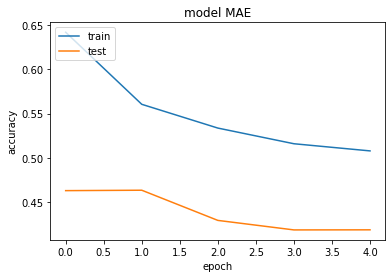

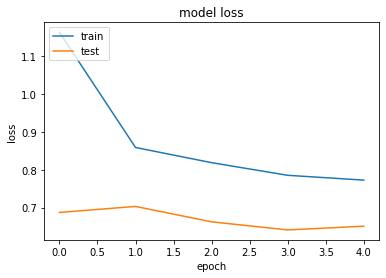

In [269]:
%matplotlib inline
import pickle
import numpy as np
from matplotlib import pyplot as plt

plt.plot(h.history['MAE'])
plt.plot(h.history['val_MAE'])
plt.title('model MAE')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(h.history['loss'])
plt.plot(h.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [270]:
'''data_week.loc[(data_week.id_cuadra == 2) & (data_week['dia de semana'] == 0)].reset_index(drop=True)[0:50]'''

"data_week.loc[(data_week.id_cuadra == 2) & (data_week['dia de semana'] == 0)].reset_index(drop=True)[0:50]"

In [316]:
i = 21

import tensorflow as tf

a = np.array(train_weekday[i])
a = np.reshape(a, (1,1))

b = np.array(train_street[i])
b = np.reshape(b, (1,1))

c = np.array(train_time[i])
c = np.reshape(c, (1,1))

d = np.array(train_data[i])
d = np.reshape(d, (1,3,3))
d = tf.convert_to_tensor(d, np.float64)

print('Weekday: ', a[0])
print('Street:  ', b[0])
print('Time:    ', c[0])
print('Data:    ', d[0])
print('Targets: ', targets[i])

Weekday:  [0]
Street:   [0]
Time:     [0.4340328]
Data:     tf.Tensor(
[[ 0.42361601 15.          1.        ]
 [ 0.42708828 16.          0.        ]
 [ 0.43056054 16.          1.        ]], shape=(3, 3), dtype=float64)
Targets:  17


In [317]:
print('Valor predicho: ', model.predict([a, b, d]))

import math #funcion techo
print('Valor predicho techo: ', math.ceil(model.predict([a, b, d])[0][0]))

print('Valor real: ', targets[i])

Valor predicho:  [[15.650274]]
Valor predicho techo:  16
Valor real:  17


### Para el siguiente valor (y simular calcular valores seguidos)

In [ ]:
added = 10

a = np.array(train_weekday[i+added])
a = np.reshape(a, (1,1))

b = np.array(train_street[i+added])
b = np.reshape(b, (1,1))

#c = np.array(train_time[i+added])
c = np.array(0.32)
c = np.reshape(c, (1,1))

d = np.array(train_data[i+added])
d = np.reshape(d, (1,3,3))

print('Weekday: ', a[0])
print('Street:  ', b[0])
print('Time:    ', c[0])
print('Data:    ', d[0])
print('Targets: ', 17)

In [ ]:
print('Valor predicho: ', model.predict([a, b, c, d])[0][0])

import math #funcion techo
print('Valor predicho techo: ', math.ceil(model.predict([a, b, c, d])[0][0]))

print('Valor real: ', 17)

### En este intento voy a utilizar como dato de tiempo el dia con num y la hora

### Otra red!

In [ ]:
'''#Para la calle
input_street = Input(shape=(1), name='input_street')
emb_street = Embedding(input_length=1, input_dim=max_street_num+1, output_dim=16)(input_street)
flat_street = Flatten()(emb_street)

#Para el dia de la semana
input_weekday = Input(shape=(1), name='input_weekday')
emb_weekday = Embedding(input_length=1, input_dim=7, output_dim=16)(input_weekday)
#LA LSTM LA USO PARA CUANDO VAYA A HACER ALGO DEL TIPO [dia, dia, dia...] y [tiempo (i), tiempo (i+1), tiempo (i+2)...]
#lstm_weekday = LSTM(56, return_sequences=False, recurrent_dropout=0.25)(emb_weekday)
#en vez de LSTM uso flatten
flat_weekday = Flatten()(emb_weekday)

#Para el tiempo y la ocupacion y la operacion
features = 3 #How much values ill compute (tiempo, ocupacion y operacion)
input_data = Input(shape=(train_size, features), name='input_data')
lstm = LSTM(128, return_sequences=False, recurrent_dropout=0.25)(input_data)

concat = Concatenate(axis=-1)
input_merge = concat([flat_weekday, flat_street])
input_merge = concat([input_merge, lstm])

d = Dense(64, activation='relu')(input_merge)
d = Dropout(0.25)(d)
d = Dense(256, activation='relu')(d)
d = Dropout(0.25)(d)
d = Dense(128, activation='relu')(d)
d = Dropout(0.25)(d)
out = Dense(1, activation='linear')(d)

model = Model(inputs=[input_weekday, input_street, input_data], outputs=out)
model.summary()
model.compile(loss='MSE', optimizer='adam', metrics=['MAE'])'''

In [ ]:
'''h = model.fit([train_weekday, train_street, train_data], targets, epochs=5, batch_size=128, validation_split=0.3)'''

In [ ]:
'''which_value = -1

a = np.array(train_street[which_value])
a = np.reshape(a, (1,1))

b = np.array(train_weekday[which_value])
b = np.reshape(b, (1,1))

c = np.array(train_data[which_value])
c = np.reshape(c, (1,3,3))

print('Valor predicho: ', model.predict([b, a, c])[0][0])

import math #funcion techo
print('Valor predicho techo: ', math.ceil(model.predict([b, a, c])[0][0]))

print('Valor real: ', targets[which_value])'''

### Ideas de redes:
### Cosas que deberian ir si o si de entrada: Dia de la semana, mes (cuando tenga mas datos), tiempo
### Utilizar los valores de Entrada/Salida y que prediga capacidad 
### Utilizar valores de capacidad y que prediga capacidad